# Importar librerías

In [ ]:
! pip install python-louvain
! pip install plotly
! pip install seaborn

In [17]:
import pandas as pd
import numpy as np

import networkx as nx

import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import Image
import seaborn as sns # Graficar mapas de calor
import plotly.graph_objects as go # Gráficas interactivas
from pyvis.network import Network

import community

# Lectura del archivo

In [7]:
df = pd.read_excel('Datos/Transacciones2.xlsx')

In [9]:
df.head()

,index,CUENTA_ORIGEN,CUENTA_DESTINO,VALOR,FECHA,OPERACION_SOSPECHOSA
0,0,51,476,2.025365e+06,2025-01-01 03:22:11,0
1,1,55,29,3.303254e+06,2025-01-01 10:02:44,0
2,2,41,137,3.180270e+04,2025-01-01 12:59:11,0
3,3,47,195,1.314048e+06,2025-01-02 00:39:53,0
4,4,51,409,2.402676e+06,2025-01-02 07:18:10,0


In [29]:
G = nx.DiGraph()
G.add_edges_from(zip(df['CUENTA_ORIGEN'].astype('str'), df['CUENTA_DESTINO'].astype('str')))

In [31]:
net = Network(directed = True, notebook = True)
net.from_nx(G)
net.show('Redes/grafo.html')

Redes/grafo.html


# Crear animaciones

In [38]:
# Agregar transacciones por día
df_sorted = df.sort_values(by="FECHA").reset_index(drop=True)

# Crear lista de transacciones con tiempo
edges_with_time = list(zip(
    df_sorted["CUENTA_ORIGEN"],
    df_sorted["CUENTA_DESTINO"],
    df_sorted["FECHA"]
))

# Crear grafo base y layout
G = nx.DiGraph()
all_nodes = set(df_sorted["CUENTA_ORIGEN"]).union(set(df_sorted["CUENTA_DESTINO"]))
G.add_nodes_from(all_nodes)
pos = nx.spring_layout(G, seed=42)

# Crear figura
fig, ax = plt.subplots(figsize=(10, 7))

def update(frame):
    ax.clear()
    G_temp = nx.DiGraph()
    G_temp.add_nodes_from(all_nodes)
    current_edges = edges_with_time[:frame+1]
    G_temp.add_edges_from([(u, v) for u, v, _ in current_edges])
    
    nx.draw(G_temp, pos, ax=ax, with_labels=True, node_size=200, node_color='skyblue', edge_color='gray', arrows=True)
    timestamp = current_edges[-1][2].strftime("%Y-%m-%d %H:%M:%S")
    ax.set_title(f"Evolución de la Red de Transacciones hasta {timestamp}", fontsize=14)
    ax.axis('off')

# Crear y guardar animación como GIF
ani = animation.FuncAnimation(fig, update, frames=len(edges_with_time), interval=500, repeat=False)
ani.save("Animaciones/evolucion_red_transacciones.gif", writer='pillow', fps=2)
plt.close()

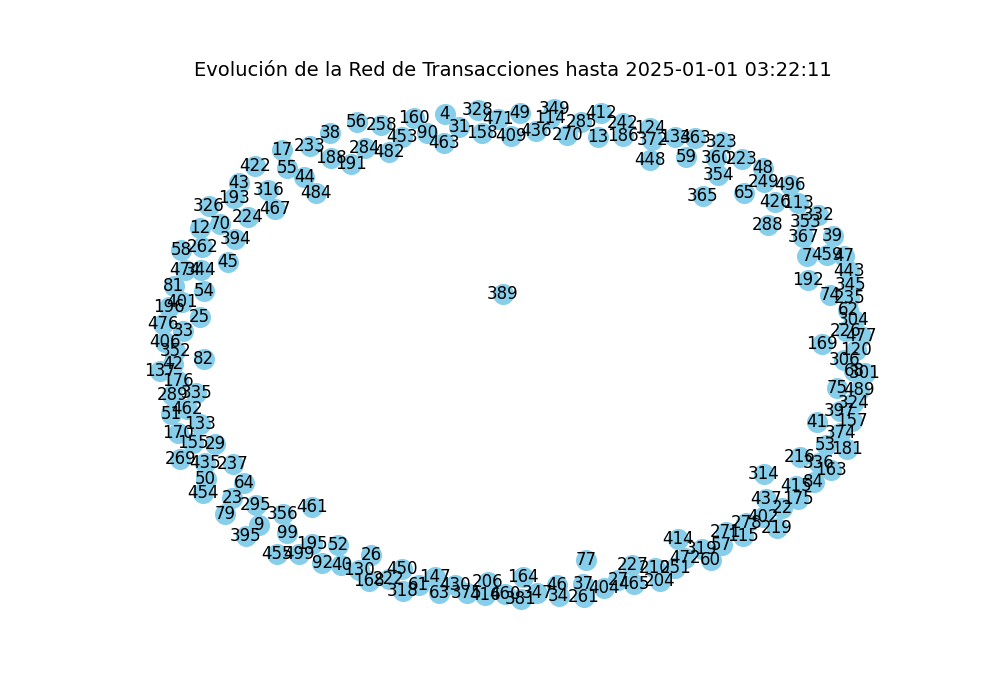

In [40]:
Image(filename="Animaciones/evolucion_red_transacciones.gif")

In [42]:
# Ver las transacciones por ventanas de tiempo
df["FECHA"] = pd.to_datetime(df["FECHA"])
df["semana"] = df["FECHA"].dt.to_period("W").apply(lambda r: r.start_time)

# 2. Construir un grafo por semana
semanas_ordenadas = sorted(df["semana"].unique())
ventanas_grafos = []

nodos_totales = set(df["CUENTA_ORIGEN"]).union(set(df["CUENTA_DESTINO"]))

for semana in semanas_ordenadas:
    df_semana = df[df["semana"] == semana]
    G = nx.from_pandas_edgelist(
        df_semana, 
        source="CUENTA_ORIGEN", 
        target="CUENTA_DESTINO", 
        create_using=nx.DiGraph()
    )
    G.add_nodes_from(nodos_totales)
    ventanas_grafos.append((str(semana), G))  # Convertir semana a string para el título

# 3. Crear un layout fijo para todos los frames
G_base = nx.DiGraph()
G_base.add_nodes_from(nodos_totales)
pos = nx.spring_layout(G_base, seed=42)

# 4. Configurar figura para animación
fig, ax = plt.subplots(figsize=(10, 7))

def actualizar(frame):
    ax.clear()
    semana_str, G = ventanas_grafos[frame]
    nx.draw(G, pos, ax=ax, with_labels=True, node_color='lightblue',
            edge_color='gray', node_size=200)
    ax.set_title(f"Red de Transacciones - Semana del {semana_str}")
    ax.axis('off')

# 5. Crear la animación
ani = animation.FuncAnimation(fig, actualizar, frames=len(ventanas_grafos), interval=1000, repeat=False)

# 6. Guardar como GIF
ani.save("Animaciones/grafo_evolucion_semanal.gif", writer='pillow', fps=1)
plt.close()

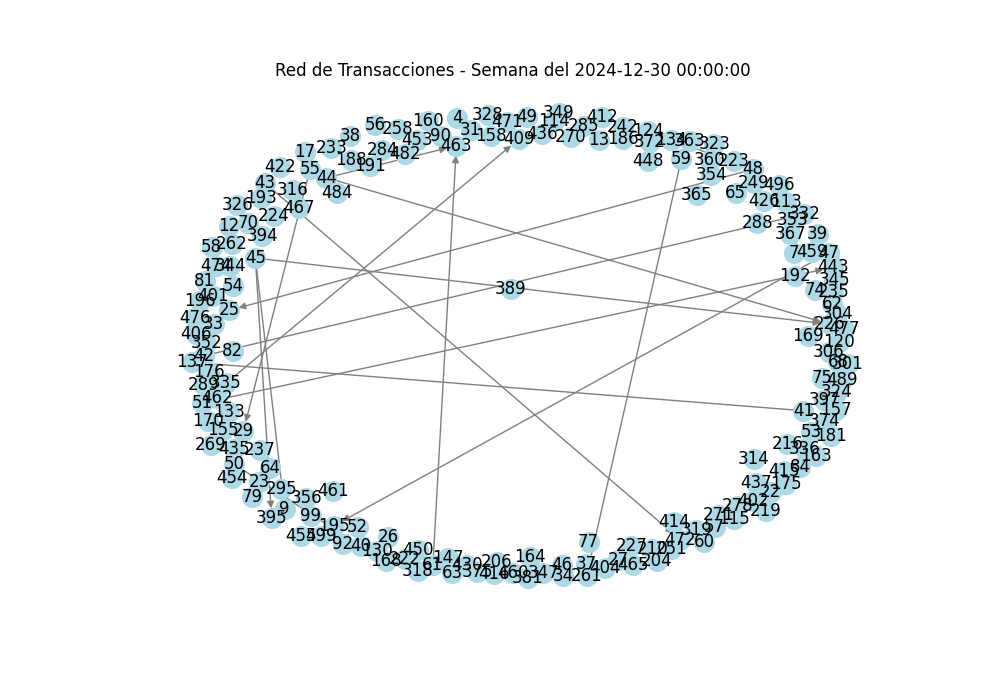

In [44]:
Image(filename="Animaciones/grafo_evolucion_semanal.gif")

# Análisis

<Axes: title={'center': 'Número de transacciones por día'}, xlabel='indice'>

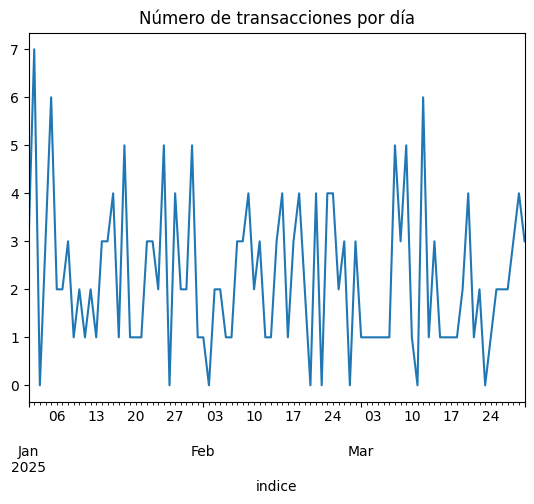

In [47]:
df['indice'] = pd.to_datetime(df['FECHA'])
df.set_index('indice', inplace = True)
actividad = df.resample('D').size()
actividad.plot(title = 'Número de transacciones por día')

<Axes: title={'center': 'Número de transacciones por semana'}, xlabel='indice'>

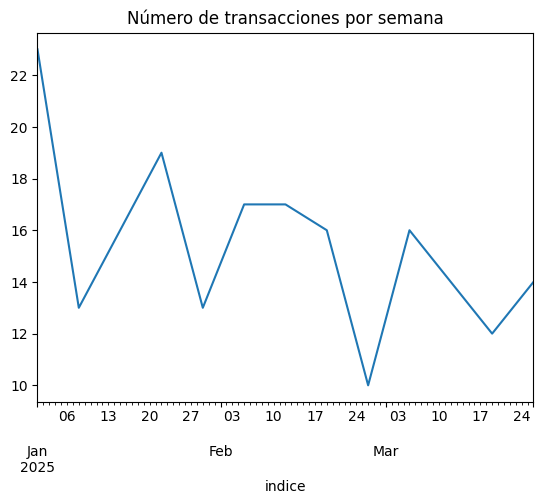

In [49]:
df['indice'] = pd.to_datetime(df['FECHA'])
df.set_index('indice', inplace = True)
actividad = df.resample('7D').size()
actividad.plot(title = 'Número de transacciones por semana')

<Axes: title={'center': 'Número de transacciones por mes'}, xlabel='indice'>

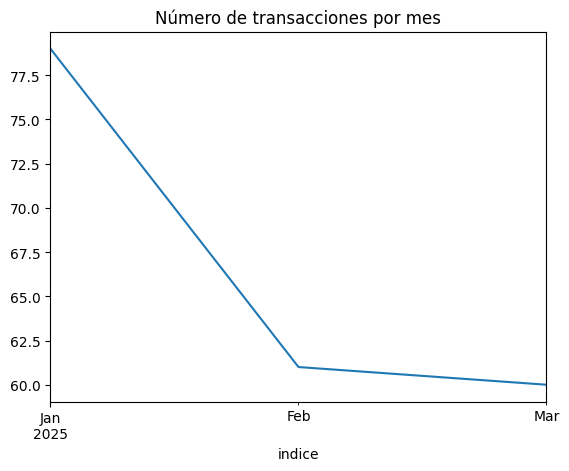

In [130]:
df['indice'] = pd.to_datetime(df['FECHA'])
df.set_index('indice', inplace = True)
actividad = df.resample('ME').size()
actividad.plot(title = 'Número de transacciones por mes')

### Saltos en transacciones por cuenta

In [90]:
df['semana'] = df['FECHA'].dt.to_period('W')

In [58]:
df.head()

,index,CUENTA_ORIGEN,CUENTA_DESTINO,VALOR,FECHA,OPERACION_SOSPECHOSA,semana
indice,,,,,,,
2025-01-01 03:22:11,0,51,476,2.025365e+06,2025-01-01 03:22:11,0,2024-12-30/2025-01-05
2025-01-01 10:02:44,1,55,29,3.303254e+06,2025-01-01 10:02:44,0,2024-12-30/2025-01-05
2025-01-01 12:59:11,2,41,137,3.180270e+04,2025-01-01 12:59:11,0,2024-12-30/2025-01-05
2025-01-02 00:39:53,3,47,195,1.314048e+06,2025-01-02 00:39:53,0,2024-12-30/2025-01-05
2025-01-02 07:18:10,4,51,409,2.402676e+06,2025-01-02 07:18:10,0,2024-12-30/2025-01-05


In [74]:
conteo

semana,2024-12-30/2025-01-05,2025-01-06/2025-01-12,2025-01-13/2025-01-19,2025-01-20/2025-01-26,2025-01-27/2025-02-02,2025-02-03/2025-02-09,2025-02-10/2025-02-16,2025-02-17/2025-02-23,2025-02-24/2025-03-02,2025-03-03/2025-03-09,2025-03-10/2025-03-16,2025-03-17/2025-03-23,2025-03-24/2025-03-30
CUENTA_ORIGEN,,,,,,,,,,,,,
34,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0
37,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
38,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
39,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0
40,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
41,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
42,2.0,1.0,1.0,0.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,3.0
43,1.0,0.0,0.0,0.0,0.0,1.0,2.0,0.0,0.0,1.0,0.0,0.0,1.0
44,2.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,2.0


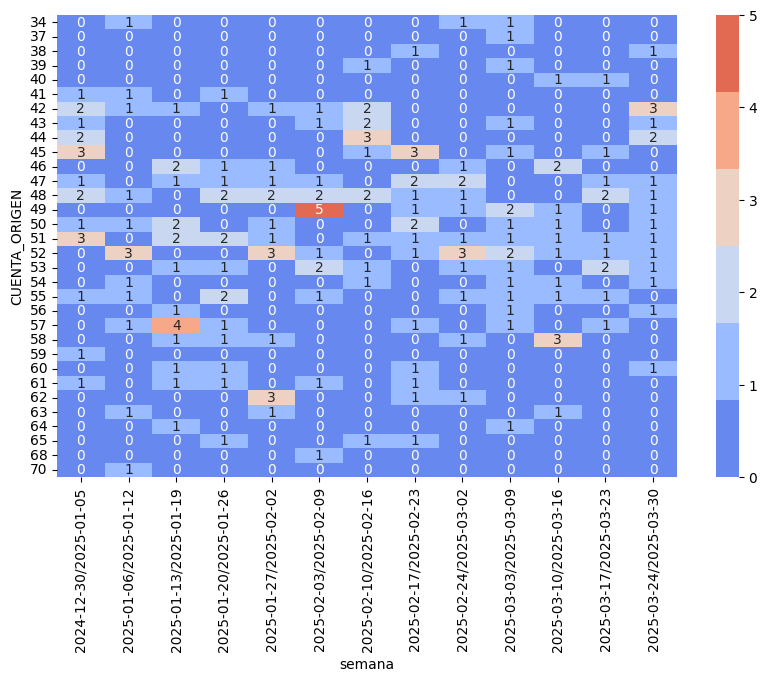

In [76]:
conteo = df.groupby(['CUENTA_ORIGEN', 'semana']).size().unstack().fillna(0)
plt.figure(figsize = (10,6))
colormap = sns.color_palette("coolwarm") 
sns.heatmap(conteo, cmap = colormap, annot = True)
plt.show()

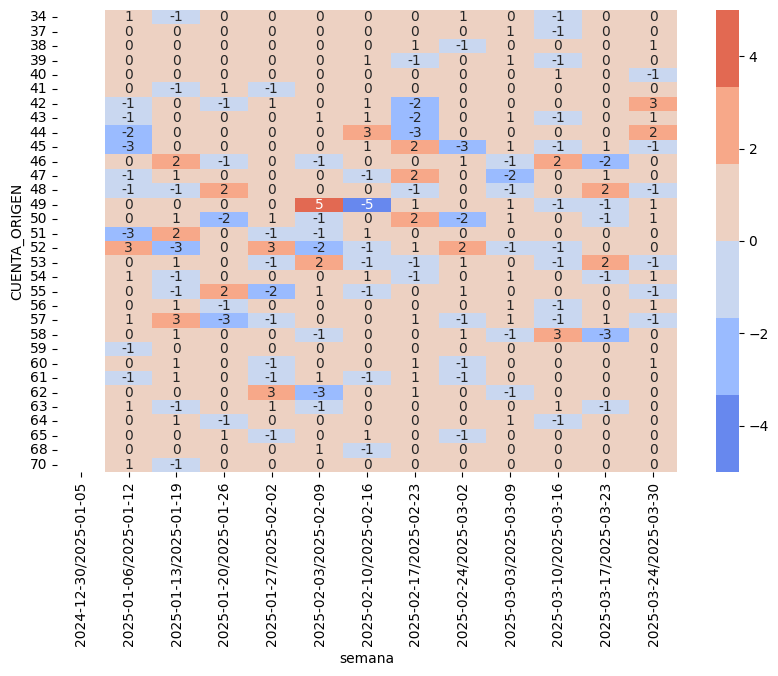

In [78]:
cambios = conteo.diff(axis = 1)
plt.figure(figsize = (10,6))
colormap = sns.color_palette("coolwarm") 
sns.heatmap(cambios, cmap = colormap, annot = True)
plt.show()

In [118]:
df["FECHA"] = pd.to_datetime(df["FECHA"])
df['semana'] = df['FECHA'].dt.to_period('W')
df["semana"] = df["semana"].dt.to_timestamp()

In [94]:
# Agrupar: número de transacciones por CUENTA_ORIGEN y semana
actividad_semanal = df.groupby(["CUENTA_ORIGEN", "semana"]).size().unstack(fill_value=0)

# Calcular la variación semanal
variacion = actividad_semanal.diff(axis=1).fillna(0)

# Generar resumen por cuenta
resumen = pd.DataFrame({
    "total_transacciones": actividad_semanal.sum(axis=1),
    "max_transacciones_semana": actividad_semanal.max(axis=1),
    "cambio_maximo": variacion.abs().max(axis=1),
    "numero_semanas_activas": (actividad_semanal > 0).sum(axis=1)
})

In [98]:
variacion

semana,2024-12-30,2025-01-06,2025-01-13,2025-01-20,2025-01-27,2025-02-03,2025-02-10,2025-02-17,2025-02-24,2025-03-03,2025-03-10,2025-03-17,2025-03-24
CUENTA_ORIGEN,,,,,,,,,,,,,
34,0.0,1,-1,0,0,0,0,0,1,0,-1,0,0
37,0.0,0,0,0,0,0,0,0,0,1,-1,0,0
38,0.0,0,0,0,0,0,0,1,-1,0,0,0,1
39,0.0,0,0,0,0,0,1,-1,0,1,-1,0,0
40,0.0,0,0,0,0,0,0,0,0,0,1,0,-1
41,0.0,0,-1,1,-1,0,0,0,0,0,0,0,0
42,0.0,-1,0,-1,1,0,1,-2,0,0,0,0,3
43,0.0,-1,0,0,0,1,1,-2,0,1,-1,0,1
44,0.0,-2,0,0,0,0,3,-3,0,0,0,0,2


In [96]:
resumen

,total_transacciones,max_transacciones_semana,cambio_maximo,numero_semanas_activas
CUENTA_ORIGEN,,,,
34,3,1,1.0,3
37,1,1,1.0,1
38,2,1,1.0,2
39,2,1,1.0,2
40,2,1,1.0,2
41,3,1,1.0,3
42,11,3,3.0,7
43,6,2,2.0,5
44,7,3,3.0,3


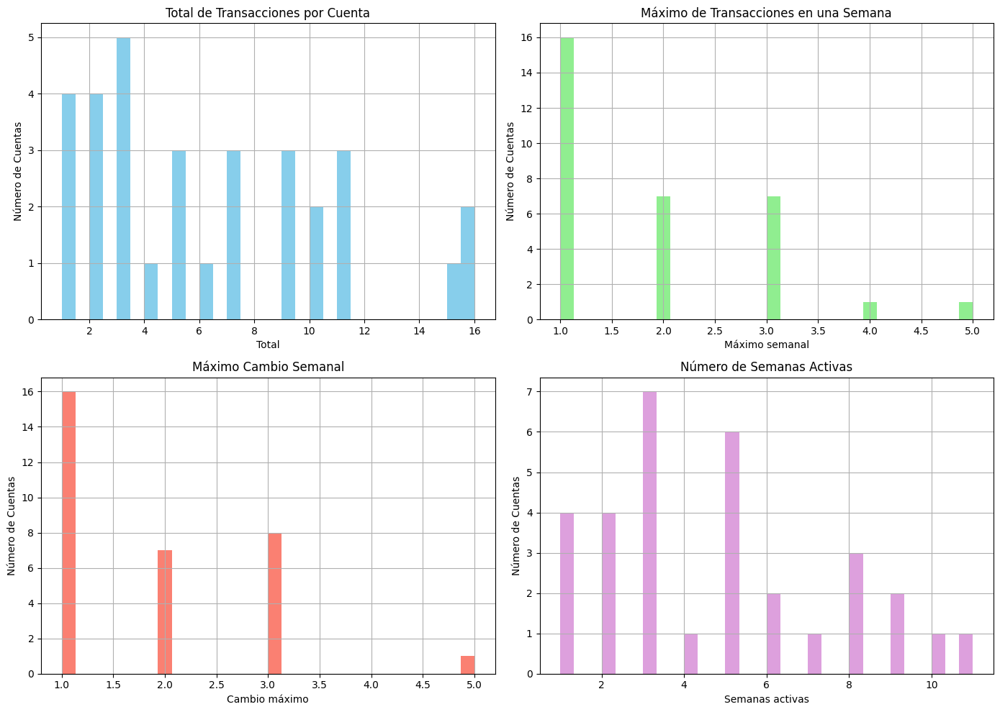

In [100]:
fig, axs = plt.subplots(2, 2, figsize=(14, 10))

resumen["total_transacciones"].hist(ax=axs[0, 0], bins=30, color="skyblue")
axs[0, 0].set_title("Total de Transacciones por Cuenta")
axs[0, 0].set_xlabel("Total")
axs[0, 0].set_ylabel("Número de Cuentas")

resumen["max_transacciones_semana"].hist(ax=axs[0, 1], bins=30, color="lightgreen")
axs[0, 1].set_title("Máximo de Transacciones en una Semana")
axs[0, 1].set_xlabel("Máximo semanal")
axs[0, 1].set_ylabel("Número de Cuentas")

resumen["cambio_maximo"].hist(ax=axs[1, 0], bins=30, color="salmon")
axs[1, 0].set_title("Máximo Cambio Semanal")
axs[1, 0].set_xlabel("Cambio máximo")
axs[1, 0].set_ylabel("Número de Cuentas")

resumen["numero_semanas_activas"].hist(ax=axs[1, 1], bins=30, color="plum")
axs[1, 1].set_title("Número de Semanas Activas")
axs[1, 1].set_xlabel("Semanas activas")
axs[1, 1].set_ylabel("Número de Cuentas")

plt.tight_layout()
plt.show()


In [108]:
# Seleccionar las cuentas más activas
cuentas_top = actividad_semanal.sum(axis=1).sort_values(ascending=False).head(10).index # para no hacerlo con to, quitar el .head(10)
df_top = actividad_semanal.loc[cuentas_top]
df_top.columns = pd.to_datetime(df_top.columns)

# Crear figura
fig = go.Figure()

for cuenta in df_top.index:
    fig.add_trace(go.Scatter(
        x=df_top.columns,
        y=df_top.loc[cuenta],
        mode='lines+markers',
        name=str(cuenta)
    ))

fig.update_layout(
    title="Evolución Semanal de Transacciones - Cuentas más Activas",
    xaxis_title="Semana",
    yaxis_title="Número de Transacciones",
    legend_title="Cuenta de Origen",
    template="plotly_white",
    height=600,
    width=1000
)

fig.show()

In [112]:
cuentas_top = actividad_semanal.sum(axis=1).sort_values(ascending=False).index
df_top = actividad_semanal.loc[cuentas_top]
df_top.columns = pd.to_datetime(df_top.columns)

# Crear figura
fig = go.Figure()

# Añadir todas las series, pero inicialmente solo mostrar la primera
for i, cuenta in enumerate(df_top.index):
    visible = True if i == 0 else False
    fig.add_trace(go.Scatter(
        x=df_top.columns,
        y=df_top.loc[cuenta],
        mode='lines+markers',
        name=str(cuenta),
        visible=visible
    ))

# Crear botones para cada cuenta
botones = []
for i, cuenta in enumerate(df_top.index):
    visibilidad = [j == i for j in range(len(df_top.index))]
    botones.append(dict(
        label=str(cuenta),
        method="update",
        args=[{"visible": visibilidad},
              {"title": f"Evolución semanal de transacciones - Cuenta {cuenta}"}]
    ))

# Añadir menú desplegable
fig.update_layout(
    updatemenus=[dict(
        active=0,
        buttons=botones,
        direction="down",
        x=1.15,
        y=1.15
    )],
    title="Evolución semanal de transacciones - Cuenta más activa",
    xaxis_title="Semana",
    yaxis_title="Número de Transacciones",
    template="plotly_white",
    height=600,
    width=1000
)

fig.show()


In [126]:
# Calcular métricas por semana
semanas = df["semana"].unique()
metricas = []

for semana in sorted(semanas):
    df_semana = df[df["semana"] == semana]
    G = nx.from_pandas_edgelist(df_semana, "CUENTA_ORIGEN", "CUENTA_DESTINO", create_using=nx.DiGraph())

    componentes = nx.number_weakly_connected_components(G)
    ciclos = len(list(nx.simple_cycles(G)))
    densidad = nx.density(G)

    # Detección de comunidades (requiere comunidad-louvain)
    try:
        undirected = G.to_undirected()
        partition = community.best_partition(undirected)
        comunidades = len(set(partition.values()))
        aristas = nx.number_of_edges(G)
    except:
        comunidades = None

    metricas.append({
        "semana": semana,
        "componentes_conexas": componentes,
        "ciclos": ciclos,
        "comunidades": comunidades,
        "densidad": densidad,
        "transacciones" : aristas
    })

df_metricas = pd.DataFrame(metricas)
df_metricas

,semana,componentes_conexas,ciclos,comunidades,densidad,transacciones
0,2024-12-30,10,0,10,0.023399,19
1,2025-01-06,10,0,10,0.025692,13
2,2025-01-13,8,0,9,0.027692,18
3,2025-01-20,11,0,11,0.023077,15
4,2025-01-27,9,0,9,0.027174,15
5,2025-02-03,10,0,10,0.024615,16
6,2025-02-10,10,0,10,0.025000,15
7,2025-02-17,12,0,12,0.020936,17
8,2025-02-24,11,0,11,0.023333,14
9,2025-03-03,15,0,15,0.017137,17


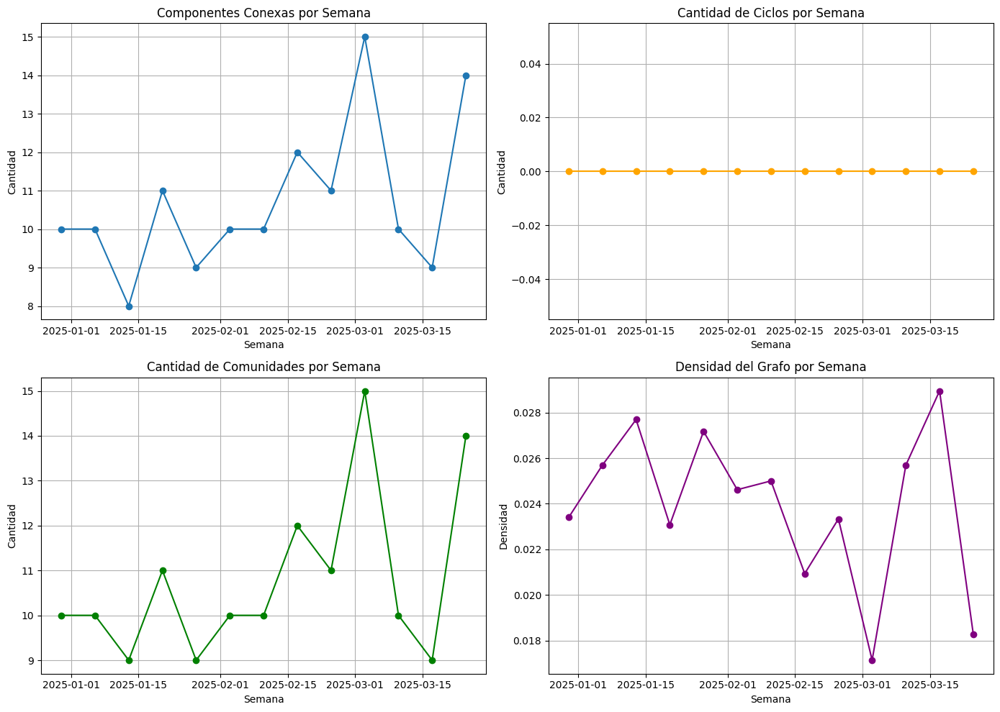

In [128]:
# Crear figura
fig, axs = plt.subplots(2, 2, figsize=(14, 10))

axs[0, 0].plot(df_metricas["semana"], df_metricas["componentes_conexas"], marker='o')
axs[0, 0].set_title("Componentes Conexas por Semana")
axs[0, 0].set_ylabel("Cantidad")
axs[0, 0].grid(True)

axs[0, 1].plot(df_metricas["semana"], df_metricas["ciclos"], marker='o', color='orange')
axs[0, 1].set_title("Cantidad de Ciclos por Semana")
axs[0, 1].set_ylabel("Cantidad")
axs[0, 1].grid(True)

axs[1, 0].plot(df_metricas["semana"], df_metricas["comunidades"], marker='o', color='green')
axs[1, 0].set_title("Cantidad de Comunidades por Semana")
axs[1, 0].set_ylabel("Cantidad")
axs[1, 0].grid(True)

axs[1, 1].plot(df_metricas["semana"], df_metricas["densidad"], marker='o', color='purple')
axs[1, 1].set_title("Densidad del Grafo por Semana")
axs[1, 1].set_ylabel("Densidad")
axs[1, 1].grid(True)

for ax in axs.flat:
    ax.set_xlabel("Semana")

plt.tight_layout()
plt.show()